### Part I. Data Preprocessing

In this section, we will extract the image URLs and compile them into a list for subsequent operations. Additionally, we will organize the data into structured DataFrames to create an optimal format for model implementation in later stages.

#### 1. Scrape Image

In [ ]:
import requests
import pandas as pd

In [ ]:
from google.colab import files

# This will open a file browser to upload files
uploaded = files.upload()

KeyboardInterrupt: 

In [ ]:
import zipfile
import os

# Unzip the file
zip_file = "WikiArt-Emotions.zip"  # Replace with your file name
with zipfile.ZipFile(zip_file, 'r') as zip_ref:
    zip_ref.extractall("WikiArt-Emotions")  # Extract to a folder named WikiArt-Emotions

# List extracted files
print(os.listdir("WikiArt-Emotions"))

FileNotFoundError: [Errno 2] No such file or directory: 'WikiArt-Emotions.zip'

In [ ]:
for root, dirs, files in os.walk("WikiArt-Emotions"):
    print(f"Current Directory: {root}")
    print(f"Subdirectories: {dirs}")
    print(f"Files: {files}")
    print("-" * 40)

Current Directory: WikiArt-Emotions
Subdirectories: ['WikiArt-Emotions', '__MACOSX']
Files: []
----------------------------------------
Current Directory: WikiArt-Emotions/WikiArt-Emotions
Subdirectories: []
Files: ['README.txt', 'WikiArt-Emotions-Ag3.tsv', 'WikiArt-Emotions-Ag5.tsv', 'WikiArt-Emotions-All.tsv', 'WikiArt-annotations.csv', 'WikiArt-info.tsv', 'WikiArt-Emotions-Ag4.tsv']
----------------------------------------
Current Directory: WikiArt-Emotions/__MACOSX
Subdirectories: ['WikiArt-Emotions']
Files: ['._WikiArt-Emotions']
----------------------------------------
Current Directory: WikiArt-Emotions/__MACOSX/WikiArt-Emotions
Subdirectories: []
Files: ['._WikiArt-Emotions-All.tsv', '._WikiArt-Emotions-Ag3.tsv', '._WikiArt-info.tsv', '._WikiArt-Emotions-Ag4.tsv', '._WikiArt-annotations.csv', '._README.txt', '._WikiArt-Emotions-Ag5.tsv']
----------------------------------------


In [ ]:
print(len(os.listdir("WikiArt-Emotions/WikiArt-Emotions")))

7


In [ ]:
wikiart = pd.read_csv('WikiArt-Emotions/WikiArt-Emotions/WikiArt-info.tsv', sep='\t')

In [ ]:
wikiart.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4119 entries, 0 to 4118
Data columns (total 8 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   ID                 4119 non-null   object
 1   Category           4119 non-null   object
 2   Artist             4119 non-null   object
 3   Title              4119 non-null   object
 4   Year               4119 non-null   object
 5   Image URL          4119 non-null   object
 6   Painting Info URL  4119 non-null   object
 7   Artist Info URL    4119 non-null   object
dtypes: object(8)
memory usage: 257.6+ KB


In [ ]:
wikiart.head(3)

,ID,Category,Artist,Title,Year,Image URL,Painting Info URL,Artist Info URL
0,58c6237dedc2c9c7dc0de1ae,Impressionism,Charles Courtney Curran,In the Luxembourg Garden,1889,https://uploads3.wikiart.org/00123/images/char...,https://www.wikiart.org/en/charles-courtney-cu...,https://www.wikiart.org/en/charles-courtney-cu...
1,577280dfedc2cb3880f28e76,Neo-Expressionism,Keith Haring,The Marriage of Heaven and Hell,1984,https://uploads1.wikiart.org/images/keith-hari...,https://www.wikiart.org/en/keith-haring/the-ma...,https://www.wikiart.org/en/keith-haring
2,57727f2dedc2cb3880ed5fa9,Post-Impressionism,Jozsef Rippl-Ronai,Uncle Piacsek in front of the Black Sideboard,1906,https://uploads3.wikiart.org/images/j-zsef-rip...,https://www.wikiart.org/en/jozsef-rippl-ronai/...,https://www.wikiart.org/en/jozsef-rippl-ronai


In [ ]:
url_list = wikiart["Image URL"].to_list()
url_list

['https://uploads3.wikiart.org/00123/images/charles-courtney-curran/in-the-luxembourg-garden-1889.jpg',
 'https://uploads1.wikiart.org/images/keith-haring/the-marriage-of-heaven-and-hell-1984.jpg',
 'https://uploads3.wikiart.org/images/j-zsef-rippl-r-nai/uncle-piacsek-in-front-of-the-black-sideboard-1906.jpg',
 'https://uploads2.wikiart.org/00124/images/vadym-meller/monk-for-the-play-mazeppa-1920.jpg',
 'https://uploads6.wikiart.org/images/david-wilkie/the-defence-of-sarago-a.jpg',
 'https://uploads4.wikiart.org/images/lyonel-feininger/in-a-village-near-paris-street-in-paris-pink-sky-1909.jpg',
 'https://uploads1.wikiart.org/images/nikolai-ge/last-supper.jpg',
 'https://uploads7.wikiart.org/images/charles-francois-daubigny/spring-1857.jpg',
 'https://uploads7.wikiart.org/images/robert-smithson/mirror-and-crushed-shells-1969.jpg',
 'https://uploads7.wikiart.org/images/richard-serra/one-ton-prop-house-of-cards-1969.jpg',
 'https://uploads8.wikiart.org/images/patrick-procktor/back-bay-in-

In [ ]:
import os
import time
import requests

index = 0
for url in url_list:
    file_name = f"{wikiart.ID.iloc[index]}.png"
    if os.path.exists(file_name):
        print(f"File {file_name} already exists, skipping...")
    else:
        try:
            response = requests.get(url, timeout=10)
            with open(file_name, "wb") as file:
                file.write(response.content)
            print(f"Downloaded: {file_name}")
        except Exception as e:
            print(f"Error downloading {file_name}: {e}")
    index += 1
    time.sleep(1)

File 58c6237dedc2c9c7dc0de1ae.png already exists, skipping...
File 577280dfedc2cb3880f28e76.png already exists, skipping...
File 57727f2dedc2cb3880ed5fa9.png already exists, skipping...
File 58d1240cedc2c94f900fc610.png already exists, skipping...
File 57727de7edc2cb3880e91f26.png already exists, skipping...
File 57728297edc2cb3880f81f5b.png already exists, skipping...
File 5772797dedc2cb3880db5504.png already exists, skipping...
Downloaded: 57726e48edc2cb3880b69b14.png
Downloaded: 57728255edc2cb3880f7644a.png
Downloaded: 5772843bedc2cb3880fd334d.png
Downloaded: 577285b4edc2cb388001c741.png
Downloaded: 5772898cedc2cb38800df3fd.png
Downloaded: 5772849eedc2cb3880fe72ab.png
Downloaded: 577282b3edc2cb3880f89e19.png
Downloaded: 577284a7edc2cb3880fe813a.png
Downloaded: 57727ca4edc2cb3880e54008.png
Downloaded: 57726ff3edc2cb3880bc56a7.png
Downloaded: 577288deedc2cb38800bdf0f.png
Downloaded: 57726e25edc2cb3880b60a8b.png
Downloaded: 577288ddedc2cb38800bde1d.png
Downloaded: 577287d9edc2cb3880089

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
drive_folder = "/content/drive/My Drive/WikiArtImages"

# Create the directory if it doesn't exist
if not os.path.exists(drive_folder):
    os.makedirs(drive_folder)

In [ ]:
import shutil

# Source directory containing images in Colab
source_folder = "/content"  # Replace with the directory where your images are stored

# Move all images to Google Drive
for file_name in os.listdir(source_folder):
    if file_name.endswith(".png"):  # Adjust the file extension if needed
        full_file_name = os.path.join(source_folder, file_name)
        if os.path.isfile(full_file_name):
            shutil.move(full_file_name, drive_folder)

print("All images have been moved to Google Drive!")

All images have been moved to Google Drive!


####2. Organize Metadata

* Url DF: WikiArt data- The information on each piece and the URL it's stored at(table used in scraping)
* Emotions DF: Emotions associated with each artwork (used for building model)
* Top Emotion DF: Emotion probability- Probability of each association associated with each artwork (in case of further need)
* Top Emotion Path DF: Create the dataframe that lists the top emotion for each artwork and the pathway for the work, which will then be used for image loading with flow_from_dataframe function
* All Emotions Path DF: Similar dataframe binary coding each emotion for all the artworks.

In [ ]:
import numpy as np
import pandas as pd
import pathlib
import PIL
from glob import glob
import matplotlib.pyplot as plt
import random
import seaborn as sns

In [ ]:
url_df = pd.read_csv('WikiArt-Emotions/WikiArt-Emotions/WikiArt-info.tsv', sep='\t')

url_df.columns

Index(['ID', 'Category', 'Artist', 'Title', 'Year', 'Image URL',
       'Painting Info URL', 'Artist Info URL'],
      dtype='object')

In [ ]:
url_df.head(3)

,ID,Category,Artist,Title,Year,Image URL,Painting Info URL,Artist Info URL
0,58c6237dedc2c9c7dc0de1ae,Impressionism,Charles Courtney Curran,In the Luxembourg Garden,1889,https://uploads3.wikiart.org/00123/images/char...,https://www.wikiart.org/en/charles-courtney-cu...,https://www.wikiart.org/en/charles-courtney-cu...
1,577280dfedc2cb3880f28e76,Neo-Expressionism,Keith Haring,The Marriage of Heaven and Hell,1984,https://uploads1.wikiart.org/images/keith-hari...,https://www.wikiart.org/en/keith-haring/the-ma...,https://www.wikiart.org/en/keith-haring
2,57727f2dedc2cb3880ed5fa9,Post-Impressionism,Jozsef Rippl-Ronai,Uncle Piacsek in front of the Black Sideboard,1906,https://uploads3.wikiart.org/images/j-zsef-rip...,https://www.wikiart.org/en/jozsef-rippl-ronai/...,https://www.wikiart.org/en/jozsef-rippl-ronai


In [ ]:
emotions_df_5 = pd.read_csv('WikiArt-Emotions/WikiArt-Emotions/WikiArt-Emotions-Ag5.tsv', sep='\t')
emotions_df_5.head(3)

,ID,Style,Category,Artist,Title,Year,Is painting,Face/body,Ave. art rating,Art (image+title): agreeableness,...,TitleOnly: love,TitleOnly: optimism,TitleOnly: pessimism,TitleOnly: regret,TitleOnly: sadness,TitleOnly: shame,TitleOnly: shyness,TitleOnly: surprise,TitleOnly: trust,TitleOnly: neutral
0,58c6237dedc2c9c7dc0de1ae,Modern Art,Impressionism,Charles Courtney Curran,In the Luxembourg Garden,1889,yes,face,2.33,0,...,0,0,0,0,0,0,0,0,0,0
1,577280dfedc2cb3880f28e76,Modern Art,Neo-Expressionism,Keith Haring,The Marriage of Heaven and Hell,1984,yes,body,0.70,0,...,0,0,0,0,0,0,0,0,0,0
2,57727f2dedc2cb3880ed5fa9,Modern Art,Post-Impressionism,Jozsef Rippl-Ronai,Uncle Piacsek in front of the Black Sideboard,1906,yes,face,1.60,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
emotions_df_3 = pd.read_csv('WikiArt-Emotions/WikiArt-Emotions/WikiArt-Emotions-Ag3.tsv', sep='\t')
emotions_df_4 = pd.read_csv('WikiArt-Emotions/WikiArt-Emotions/WikiArt-Emotions-Ag4.tsv', sep='\t')
print(emotions_df_3.equals(emotions_df_5))
print(emotions_df_4.equals(emotions_df_5))
print(emotions_df_4.equals(emotions_df_3))

False
False
False


In [ ]:
emotions_df_3.head(3)

,ID,Style,Category,Artist,Title,Year,Is painting,Face/body,Ave. art rating,Art (image+title): agreeableness,...,TitleOnly: love,TitleOnly: optimism,TitleOnly: pessimism,TitleOnly: regret,TitleOnly: sadness,TitleOnly: shame,TitleOnly: shyness,TitleOnly: surprise,TitleOnly: trust,TitleOnly: neutral
0,58c6237dedc2c9c7dc0de1ae,Modern Art,Impressionism,Charles Courtney Curran,In the Luxembourg Garden,1889,yes,face,2.33,0,...,0,0,0,0,0,0,0,0,0,0
1,577280dfedc2cb3880f28e76,Modern Art,Neo-Expressionism,Keith Haring,The Marriage of Heaven and Hell,1984,yes,body,0.70,0,...,0,0,0,0,0,0,0,0,0,0
2,57727f2dedc2cb3880ed5fa9,Modern Art,Post-Impressionism,Jozsef Rippl-Ronai,Uncle Piacsek in front of the Black Sideboard,1906,yes,face,1.60,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
emotions_df_4.head(3)

,ID,Style,Category,Artist,Title,Year,Is painting,Face/body,Ave. art rating,Art (image+title): agreeableness,...,TitleOnly: love,TitleOnly: optimism,TitleOnly: pessimism,TitleOnly: regret,TitleOnly: sadness,TitleOnly: shame,TitleOnly: shyness,TitleOnly: surprise,TitleOnly: trust,TitleOnly: neutral
0,58c6237dedc2c9c7dc0de1ae,Modern Art,Impressionism,Charles Courtney Curran,In the Luxembourg Garden,1889,yes,face,2.33,0,...,0,0,0,0,0,0,0,0,0,0
1,577280dfedc2cb3880f28e76,Modern Art,Neo-Expressionism,Keith Haring,The Marriage of Heaven and Hell,1984,yes,body,0.70,0,...,0,0,0,0,0,0,0,0,0,0
2,57727f2dedc2cb3880ed5fa9,Modern Art,Post-Impressionism,Jozsef Rippl-Ronai,Uncle Piacsek in front of the Black Sideboard,1906,yes,face,1.60,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
diff_3_5 = emotions_df_3.eq(emotions_df_5)
diff_3_5.head(10)

,ID,Style,Category,Artist,Title,Year,Is painting,Face/body,Ave. art rating,Art (image+title): agreeableness,...,TitleOnly: love,TitleOnly: optimism,TitleOnly: pessimism,TitleOnly: regret,TitleOnly: sadness,TitleOnly: shame,TitleOnly: shyness,TitleOnly: surprise,TitleOnly: trust,TitleOnly: neutral
0,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
1,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
2,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
3,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
4,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,False,True
5,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
6,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,False,True,True,True,True,True
7,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
8,True,True,True,True,True,True,True,True,True,True,...,True,True,False,True,True,True,True,True,True,True
9,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True


In [ ]:
diff_3_5["TitleOnly: optimism"].value_counts()

,count
TitleOnly: optimism,
True,3765
False,340


In [ ]:
diff_4_5 = emotions_df_4.eq(emotions_df_5)
diff_4_5.head(10)

,ID,Style,Category,Artist,Title,Year,Is painting,Face/body,Ave. art rating,Art (image+title): agreeableness,...,TitleOnly: love,TitleOnly: optimism,TitleOnly: pessimism,TitleOnly: regret,TitleOnly: sadness,TitleOnly: shame,TitleOnly: shyness,TitleOnly: surprise,TitleOnly: trust,TitleOnly: neutral
0,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
1,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
2,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
3,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
4,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
5,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
6,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
7,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
8,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
9,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True


In [ ]:
diff_4_5["TitleOnly: optimism"].value_counts()

,count
TitleOnly: optimism,
True,4027
False,78


In [ ]:
diff_3_4 = emotions_df_3.eq(emotions_df_4)
diff_3_4.head(10)

,ID,Style,Category,Artist,Title,Year,Is painting,Face/body,Ave. art rating,Art (image+title): agreeableness,...,TitleOnly: love,TitleOnly: optimism,TitleOnly: pessimism,TitleOnly: regret,TitleOnly: sadness,TitleOnly: shame,TitleOnly: shyness,TitleOnly: surprise,TitleOnly: trust,TitleOnly: neutral
0,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
1,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
2,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
3,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
4,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,False,True
5,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
6,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,False,True,True,True,True,True
7,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
8,True,True,True,True,True,True,True,True,True,True,...,True,True,False,True,True,True,True,True,True,True
9,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True


In [ ]:
diff_3_4["TitleOnly: optimism"].value_counts()

,count
TitleOnly: optimism,
True,3843
False,262


In [ ]:
emotions_df_3.columns

Index(['ID', 'Style', 'Category', 'Artist', 'Title', 'Year', 'Is painting',
       'Face/body', 'Ave. art rating', 'Art (image+title): agreeableness',
       'Art (image+title): anger', 'Art (image+title): anticipation',
       'Art (image+title): arrogance', 'Art (image+title): disagreeableness',
       'Art (image+title): disgust', 'Art (image+title): fear',
       'Art (image+title): gratitude', 'Art (image+title): happiness',
       'Art (image+title): humility', 'Art (image+title): love',
       'Art (image+title): optimism', 'Art (image+title): pessimism',
       'Art (image+title): regret', 'Art (image+title): sadness',
       'Art (image+title): shame', 'Art (image+title): shyness',
       'Art (image+title): surprise', 'Art (image+title): trust',
       'Art (image+title): neutral', 'ImageOnly: agreeableness',
       'ImageOnly: anger', 'ImageOnly: anticipation', 'ImageOnly: arrogance',
       'ImageOnly: disagreeableness', 'ImageOnly: disgust', 'ImageOnly: fear',
       'Imag

In [ ]:
emotions_overall = emotions_df_3[['ID', 'Style', 'Category', 'Artist', 'Title', 'Is painting',
       'Face/body', 'Art (image+title): agreeableness',
       'Art (image+title): anger', 'Art (image+title): anticipation',
       'Art (image+title): arrogance', 'Art (image+title): disagreeableness',
       'Art (image+title): disgust', 'Art (image+title): fear',
       'Art (image+title): gratitude', 'Art (image+title): happiness',
       'Art (image+title): humility', 'Art (image+title): love',
       'Art (image+title): optimism', 'Art (image+title): pessimism',
       'Art (image+title): regret', 'Art (image+title): sadness',
       'Art (image+title): shame', 'Art (image+title): shyness',
       'Art (image+title): surprise', 'Art (image+title): trust',
       'Art (image+title): neutral']]
emotions_overall.head(3)

,ID,Style,Category,Artist,Title,Is painting,Face/body,Art (image+title): agreeableness,Art (image+title): anger,Art (image+title): anticipation,...,Art (image+title): love,Art (image+title): optimism,Art (image+title): pessimism,Art (image+title): regret,Art (image+title): sadness,Art (image+title): shame,Art (image+title): shyness,Art (image+title): surprise,Art (image+title): trust,Art (image+title): neutral
0,58c6237dedc2c9c7dc0de1ae,Modern Art,Impressionism,Charles Courtney Curran,In the Luxembourg Garden,yes,face,0,0,0,...,1,1,0,0,0,0,0,0,0,0
1,577280dfedc2cb3880f28e76,Modern Art,Neo-Expressionism,Keith Haring,The Marriage of Heaven and Hell,yes,body,0,0,1,...,0,0,0,0,0,0,0,1,0,0
2,57727f2dedc2cb3880ed5fa9,Modern Art,Post-Impressionism,Jozsef Rippl-Ronai,Uncle Piacsek in front of the Black Sideboard,yes,face,0,0,0,...,0,1,0,0,0,0,0,0,1,0


In [ ]:
emotions = emotions_overall.rename(columns={'Art (image+title): agreeableness': 'agreeableness',
       'Art (image+title): anger': "anger", 'Art (image+title): anticipation': "anticipation",
       'Art (image+title): arrogance':"arrogance", 'Art (image+title): disagreeableness':"disagreeableness",
       'Art (image+title): disgust':"disgust", 'Art (image+title): fear':"fear",
       'Art (image+title): gratitude':"gratitude", 'Art (image+title): happiness':"happiness",
       'Art (image+title): humility':"humility", 'Art (image+title): love':"love",
       'Art (image+title): optimism':"optimism", 'Art (image+title): pessimism':"pessimism",
       'Art (image+title): regret':"regret", 'Art (image+title): sadness':"sadness",
       'Art (image+title): shame':"shame", 'Art (image+title): shyness':"shyness",
       'Art (image+title): surprise':"surprise", 'Art (image+title): trust':"trust",
       'Art (image+title): neutral':"neutral"})
emotions.head(1)

,ID,Style,Category,Artist,Title,Is painting,Face/body,agreeableness,anger,anticipation,...,love,optimism,pessimism,regret,sadness,shame,shyness,surprise,trust,neutral
0,58c6237dedc2c9c7dc0de1ae,Modern Art,Impressionism,Charles Courtney Curran,In the Luxembourg Garden,yes,face,0,0,0,...,1,1,0,0,0,0,0,0,0,0


In [ ]:
prob_df = pd.read_csv('WikiArt-Emotions/WikiArt-Emotions/WikiArt-Emotions-All.tsv', sep='\t')
prob_df.head(3)

,ID,Style,Category,Artist,Title,Year,Is painting,Face/body,Ave. art rating,Art (image+title): agreeableness,...,TitleOnly: love,TitleOnly: optimism,TitleOnly: pessimism,TitleOnly: regret,TitleOnly: sadness,TitleOnly: shame,TitleOnly: shyness,TitleOnly: surprise,TitleOnly: trust,TitleOnly: neutral
0,58c6237dedc2c9c7dc0de1ae,Modern Art,Impressionism,Charles Courtney Curran,In the Luxembourg Garden,1889,yes,face,2.33,0.036,...,0.155,0.238,0.024,0.012,0.024,0.012,0.0,0.048,0.155,0.0
1,577280dfedc2cb3880f28e76,Modern Art,Neo-Expressionism,Keith Haring,The Marriage of Heaven and Hell,1984,yes,body,0.70,0.000,...,0.200,0.000,0.100,0.000,0.000,0.000,0.0,0.200,0.000,0.0
2,57727f2dedc2cb3880ed5fa9,Modern Art,Post-Impressionism,Jozsef Rippl-Ronai,Uncle Piacsek in front of the Black Sideboard,1906,yes,face,1.60,0.000,...,0.000,0.000,0.000,0.000,0.000,0.000,0.0,0.100,0.100,0.0


In [ ]:
prob_df2 = prob_df.copy()

In [ ]:
prob_df3 = prob_df2[['ID', 'Artist', 'Title','Art (image+title): agreeableness',
       'Art (image+title): anger', 'Art (image+title): anticipation',
       'Art (image+title): arrogance', 'Art (image+title): disagreeableness',
       'Art (image+title): disgust', 'Art (image+title): fear',
       'Art (image+title): gratitude', 'Art (image+title): happiness',
       'Art (image+title): humility', 'Art (image+title): love',
       'Art (image+title): optimism', 'Art (image+title): pessimism',
       'Art (image+title): regret', 'Art (image+title): sadness',
       'Art (image+title): shame', 'Art (image+title): shyness',
       'Art (image+title): surprise', 'Art (image+title): trust',
       'Art (image+title): neutral']]
prob_df3.head(3)

,ID,Artist,Title,Art (image+title): agreeableness,Art (image+title): anger,Art (image+title): anticipation,Art (image+title): arrogance,Art (image+title): disagreeableness,Art (image+title): disgust,Art (image+title): fear,...,Art (image+title): love,Art (image+title): optimism,Art (image+title): pessimism,Art (image+title): regret,Art (image+title): sadness,Art (image+title): shame,Art (image+title): shyness,Art (image+title): surprise,Art (image+title): trust,Art (image+title): neutral
0,58c6237dedc2c9c7dc0de1ae,Charles Courtney Curran,In the Luxembourg Garden,0.036,0.012,0.071,0.012,0.012,0.0,0.036,...,0.357,0.333,0.048,0.024,0.131,0.0,0.012,0.048,0.274,0.0
1,577280dfedc2cb3880f28e76,Keith Haring,The Marriage of Heaven and Hell,0.000,0.000,0.500,0.000,0.400,0.1,0.300,...,0.100,0.100,0.200,0.100,0.100,0.0,0.000,0.500,0.100,0.0
2,57727f2dedc2cb3880ed5fa9,Jozsef Rippl-Ronai,Uncle Piacsek in front of the Black Sideboard,0.000,0.000,0.200,0.000,0.000,0.0,0.000,...,0.000,0.300,0.000,0.000,0.000,0.0,0.000,0.100,0.300,0.0


from matplotlib import pyplot as plt
_df_23['index'].plot(kind='hist', bins=20, title='index')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_24['Art (image+title): agreeableness'].plot(kind='hist', bins=20, title='Art (image+title): agreeableness')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_25['Art (image+title): anger'].plot(kind='hist', bins=20, title='Art (image+title): anger')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_26['Art (image+title): anticipation'].plot(kind='hist', bins=20, title='Art (image+title): anticipation')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
_df_27.groupby('ID').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
_df_28.groupby('Artist').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
_df_29.groupby('Title').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_30.plot(kind='scatter', x='index', y='Art (image+title): agreeableness', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_31.plot(kind='scatter', x='Art (image+title): agreeableness', y='Art (image+title): anger', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_32.plot(kind='scatter', x='Art (image+title): anger', y='Art (image+title): anticipation', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_33.plot(kind='scatter', x='Art (image+title): anticipation', y='Art (image+title): arrogance', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['index']
  ys = series['Art (image+title): agreeableness']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_34.sort_values('index', ascending=True)
for i, (series_name, series) in enumerate(df_sorted.groupby('ID')):
  _plot_series(series, series_name, i)
  fig.legend(title='ID', bbox_to_anchor=(1, 1), loc='upper left')
sns.despine(fig=fig, ax=ax)
plt.xlabel('index')
_ = plt.ylabel('Art (image+title): agreeableness')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['index']
  ys = series['Art (image+title): agreeableness']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_35.sort_values('index', ascending=True)
for i, (series_name, series) in enumerate(df_sorted.groupby('Artist')):
  _plot_series(series, series_name, i)
  fig.legend(title='Artist', bbox_to_anchor=(1, 1), loc='upper left')
sns.despine(fig=fig, ax=ax)
plt.xlabel('index')
_ = plt.ylabel('Art (image+title): agreeableness')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['index']
  ys = series['Art (image+title): agreeableness']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_36.sort_values('index', ascending=True)
for i, (series_name, series) in enumerate(df_sorted.groupby('Title')):
  _plot_series(series, series_name, i)
  fig.legend(title='Title', bbox_to_anchor=(1, 1), loc='upper left')
sns.despine(fig=fig, ax=ax)
plt.xlabel('index')
_ = plt.ylabel('Art (image+title): agreeableness')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['index']
  ys = series['Art (image+title): anger']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_37.sort_values('index', ascending=True)
for i, (series_name, series) in enumerate(df_sorted.groupby('ID')):
  _plot_series(series, series_name, i)
  fig.legend(title='ID', bbox_to_anchor=(1, 1), loc='upper left')
sns.despine(fig=fig, ax=ax)
plt.xlabel('index')
_ = plt.ylabel('Art (image+title): anger')

from matplotlib import pyplot as plt
_df_38['index'].plot(kind='line', figsize=(8, 4), title='index')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
_df_39['Art (image+title): agreeableness'].plot(kind='line', figsize=(8, 4), title='Art (image+title): agreeableness')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
_df_40['Art (image+title): anger'].plot(kind='line', figsize=(8, 4), title='Art (image+title): anger')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
_df_41['Art (image+title): anticipation'].plot(kind='line', figsize=(8, 4), title='Art (image+title): anticipation')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
import pandas as pd
plt.subplots(figsize=(8, 8))
df_2dhist = pd.DataFrame({
    x_label: grp['Artist'].value_counts()
    for x_label, grp in _df_42.groupby('ID')
})
sns.heatmap(df_2dhist, cmap='viridis')
plt.xlabel('ID')
_ = plt.ylabel('Artist')

from matplotlib import pyplot as plt
import seaborn as sns
import pandas as pd
plt.subplots(figsize=(8, 8))
df_2dhist = pd.DataFrame({
    x_label: grp['Title'].value_counts()
    for x_label, grp in _df_43.groupby('Artist')
})
sns.heatmap(df_2dhist, cmap='viridis')
plt.xlabel('Artist')
_ = plt.ylabel('Title')

<string>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.



from matplotlib import pyplot as plt
import seaborn as sns
figsize = (12, 1.2 * len(_df_44['ID'].unique()))
plt.figure(figsize=figsize)
sns.violinplot(_df_44, x='index', y='ID', inner='stick', palette='Dark2')
sns.despine(top=True, right=True, bottom=True, left=True)

<string>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.



from matplotlib import pyplot as plt
import seaborn as sns
figsize = (12, 1.2 * len(_df_45['Artist'].unique()))
plt.figure(figsize=figsize)
sns.violinplot(_df_45, x='index', y='Artist', inner='stick', palette='Dark2')
sns.despine(top=True, right=True, bottom=True, left=True)

<string>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.



from matplotlib import pyplot as plt
import seaborn as sns
figsize = (12, 1.2 * len(_df_46['Title'].unique()))
plt.figure(figsize=figsize)
sns.violinplot(_df_46, x='index', y='Title', inner='stick', palette='Dark2')
sns.despine(top=True, right=True, bottom=True, left=True)

<string>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.



from matplotlib import pyplot as plt
import seaborn as sns
figsize = (12, 1.2 * len(_df_47['ID'].unique()))
plt.figure(figsize=figsize)
sns.violinplot(_df_47, x='Art (image+title): agreeableness', y='ID', inner='stick', palette='Dark2')
sns.despine(top=True, right=True, bottom=True, left=True)

In [ ]:
top_emotion = prob_df3.rename(columns={'Art (image+title): agreeableness': 'agreeableness',
       'Art (image+title): anger': "anger", 'Art (image+title): anticipation': "anticipation",
       'Art (image+title): arrogance':"arrogance", 'Art (image+title): disagreeableness':"disagreeableness",
       'Art (image+title): disgust':"disgust", 'Art (image+title): fear':"fear",
       'Art (image+title): gratitude':"gratitude", 'Art (image+title): happiness':"happiness",
       'Art (image+title): humility':"humility", 'Art (image+title): love':"love",
       'Art (image+title): optimism':"optimism", 'Art (image+title): pessimism':"pessimism",
       'Art (image+title): regret':"regret", 'Art (image+title): sadness':"sadness",
       'Art (image+title): shame':"shame", 'Art (image+title): shyness':"shyness",
       'Art (image+title): surprise':"surprise", 'Art (image+title): trust':"trust",
       'Art (image+title): neutral':"neutral"})
top_emotion.head(10)

,ID,Artist,Title,agreeableness,anger,anticipation,arrogance,disagreeableness,disgust,fear,...,love,optimism,pessimism,regret,sadness,shame,shyness,surprise,trust,neutral
0,58c6237dedc2c9c7dc0de1ae,Charles Courtney Curran,In the Luxembourg Garden,0.036,0.012,0.071,0.012,0.012,0.000,0.036,...,0.357,0.333,0.048,0.024,0.131,0.000,0.012,0.048,0.274,0.000
1,577280dfedc2cb3880f28e76,Keith Haring,The Marriage of Heaven and Hell,0.000,0.000,0.500,0.000,0.400,0.100,0.300,...,0.100,0.100,0.200,0.100,0.100,0.000,0.000,0.500,0.100,0.000
2,57727f2dedc2cb3880ed5fa9,Jozsef Rippl-Ronai,Uncle Piacsek in front of the Black Sideboard,0.000,0.000,0.200,0.000,0.000,0.000,0.000,...,0.000,0.300,0.000,0.000,0.000,0.000,0.000,0.100,0.300,0.000
3,58d1240cedc2c94f900fc610,Vadym Meller,Monk. For the Play &#39;Mazeppa&#39;,0.000,0.000,0.091,0.000,0.000,0.091,0.091,...,0.000,0.091,0.091,0.091,0.273,0.000,0.091,0.182,0.000,0.000
4,57727de7edc2cb3880e91f26,David Wilkie,The Defence of Sarago&#231;a,0.077,0.231,0.154,0.231,0.308,0.231,0.308,...,0.077,0.231,0.154,0.154,0.231,0.154,0.077,0.077,0.538,0.000
5,57728297edc2cb3880f81f5b,Lyonel Feininger,"In a Village Near Paris (Street in Paris, Pink...",0.045,0.000,0.134,0.045,0.030,0.030,0.134,...,0.104,0.134,0.104,0.030,0.090,0.015,0.015,0.224,0.090,0.000
6,5772797dedc2cb3880db5504,Nikolai Ge,Last Supper,0.000,0.000,0.100,0.100,0.000,0.000,0.600,...,0.000,0.000,0.100,0.000,0.300,0.000,0.000,0.000,0.100,0.000
7,57726e48edc2cb3880b69b14,Charles-Francois Daubigny,Spring,0.000,0.000,0.000,0.000,0.000,0.000,0.000,...,0.100,0.400,0.100,0.000,0.100,0.000,0.000,0.000,0.200,0.000
8,57728255edc2cb3880f7644a,Robert Smithson,Mirror and Crushed Shells,0.000,0.000,0.417,0.000,0.083,0.083,0.083,...,0.083,0.000,0.083,0.083,0.167,0.000,0.000,0.500,0.000,0.083
9,5772843bedc2cb3880fd334d,Richard Serra,One Ton Prop (House of Cards),0.000,0.000,0.100,0.000,0.000,0.200,0.000,...,0.000,0.000,0.000,0.000,0.100,0.100,0.000,0.400,0.000,0.100


In [ ]:
#Create column with top emotion associated with artwork
prob_df4 = top_emotion.loc[:, ('agreeableness', 'anger', 'anticipation','arrogance', 'disagreeableness',
       'disgust', 'fear','gratitude', 'happiness', 'humility', 'love',
       'optimism', 'pessimism','regret', 'sadness','shame', 'shyness',
       'surprise', 'trust','neutral')]
specific = prob_df4.idxmax(axis = 1)
prob_df4["emotion"] = specific
prob_df4.head(1)

,agreeableness,anger,anticipation,arrogance,disagreeableness,disgust,fear,gratitude,happiness,humility,...,optimism,pessimism,regret,sadness,shame,shyness,surprise,trust,neutral,emotion
0,0.036,0.012,0.071,0.012,0.012,0.0,0.036,0.131,0.75,0.357,...,0.333,0.048,0.024,0.131,0.0,0.012,0.048,0.274,0.0,happiness


In [ ]:
top_emotion["emotion"] = prob_df4["emotion"]
top_emotion.head(5)

,ID,Artist,Title,agreeableness,anger,anticipation,arrogance,disagreeableness,disgust,fear,...,optimism,pessimism,regret,sadness,shame,shyness,surprise,trust,neutral,emotion
0,58c6237dedc2c9c7dc0de1ae,Charles Courtney Curran,In the Luxembourg Garden,0.036,0.012,0.071,0.012,0.012,0.000,0.036,...,0.333,0.048,0.024,0.131,0.000,0.012,0.048,0.274,0.0,happiness
1,577280dfedc2cb3880f28e76,Keith Haring,The Marriage of Heaven and Hell,0.000,0.000,0.500,0.000,0.400,0.100,0.300,...,0.100,0.200,0.100,0.100,0.000,0.000,0.500,0.100,0.0,anticipation
2,57727f2dedc2cb3880ed5fa9,Jozsef Rippl-Ronai,Uncle Piacsek in front of the Black Sideboard,0.000,0.000,0.200,0.000,0.000,0.000,0.000,...,0.300,0.000,0.000,0.000,0.000,0.000,0.100,0.300,0.0,happiness
3,58d1240cedc2c94f900fc610,Vadym Meller,Monk. For the Play &#39;Mazeppa&#39;,0.000,0.000,0.091,0.000,0.000,0.091,0.091,...,0.091,0.091,0.091,0.273,0.000,0.091,0.182,0.000,0.0,sadness
4,57727de7edc2cb3880e91f26,David Wilkie,The Defence of Sarago&#231;a,0.077,0.231,0.154,0.231,0.308,0.231,0.308,...,0.231,0.154,0.154,0.231,0.154,0.077,0.077,0.538,0.0,trust


In [ ]:
# Create image path DF
path = "/content/drive/My Drive/WikiArtImages/"
path_prob = top_emotion.copy()
path_prob = path_prob.loc[:, ("ID", "emotion")]
path_prob["path"] = path + path_prob.ID.astype(str) + ".png"



                         ID       emotion  \
0  58c6237dedc2c9c7dc0de1ae     happiness   
1  577280dfedc2cb3880f28e76  anticipation   
2  57727f2dedc2cb3880ed5fa9     happiness   
3  58d1240cedc2c94f900fc610       sadness   
4  57727de7edc2cb3880e91f26         trust   

                                                path  
0  /content/drive/My Drive/WikiArtImages/58c6237d...  
1  /content/drive/My Drive/WikiArtImages/577280df...  
2  /content/drive/My Drive/WikiArtImages/57727f2d...  
3  /content/drive/My Drive/WikiArtImages/58d1240c...  
4  /content/drive/My Drive/WikiArtImages/57727de7...  


In [ ]:
path_prob.head(10)

,ID,emotion,path
0,58c6237dedc2c9c7dc0de1ae,happiness,/content/drive/My Drive/WikiArtImages/58c6237d...
1,577280dfedc2cb3880f28e76,anticipation,/content/drive/My Drive/WikiArtImages/577280df...
2,57727f2dedc2cb3880ed5fa9,happiness,/content/drive/My Drive/WikiArtImages/57727f2d...
3,58d1240cedc2c94f900fc610,sadness,/content/drive/My Drive/WikiArtImages/58d1240c...
4,57727de7edc2cb3880e91f26,trust,/content/drive/My Drive/WikiArtImages/57727de7...
5,57728297edc2cb3880f81f5b,happiness,/content/drive/My Drive/WikiArtImages/57728297...
6,5772797dedc2cb3880db5504,fear,/content/drive/My Drive/WikiArtImages/5772797d...
7,57726e48edc2cb3880b69b14,happiness,/content/drive/My Drive/WikiArtImages/57726e48...
8,57728255edc2cb3880f7644a,surprise,/content/drive/My Drive/WikiArtImages/57728255...
9,5772843bedc2cb3880fd334d,surprise,/content/drive/My Drive/WikiArtImages/5772843b...


In [ ]:
emotions.head(1)

,ID,Style,Category,Artist,Title,Is painting,Face/body,agreeableness,anger,anticipation,...,love,optimism,pessimism,regret,sadness,shame,shyness,surprise,trust,neutral
0,58c6237dedc2c9c7dc0de1ae,Modern Art,Impressionism,Charles Courtney Curran,In the Luxembourg Garden,yes,face,0,0,0,...,1,1,0,0,0,0,0,0,0,0


In [ ]:
path_all = emotions.copy()
path_all["path"] = "/content/drive/My Drive/WikiArtImages" + path_all.ID.astype(str) + ".png"
path_all.head(1)

,ID,Style,Category,Artist,Title,Is painting,Face/body,agreeableness,anger,anticipation,...,optimism,pessimism,regret,sadness,shame,shyness,surprise,trust,neutral,path
0,58c6237dedc2c9c7dc0de1ae,Modern Art,Impressionism,Charles Courtney Curran,In the Luxembourg Garden,yes,face,0,0,0,...,1,0,0,0,0,0,0,0,0,/content/drive/My Drive/WikiArtImages58c6237de...


<class 'list'>


####3.Data Visualization

In [ ]:
#Define the directory containing images and get a list of all PNG files in the directory
data_dir = pathlib.Path("/content/drive/My Drive/WikiArtImages")

In [ ]:
emo = list(data_dir.glob('**/*.png'))
image_count = len(emo)
print(f"Number of images in the whole directory is {image_count}.")

Number of images in the whole directory is 4119.


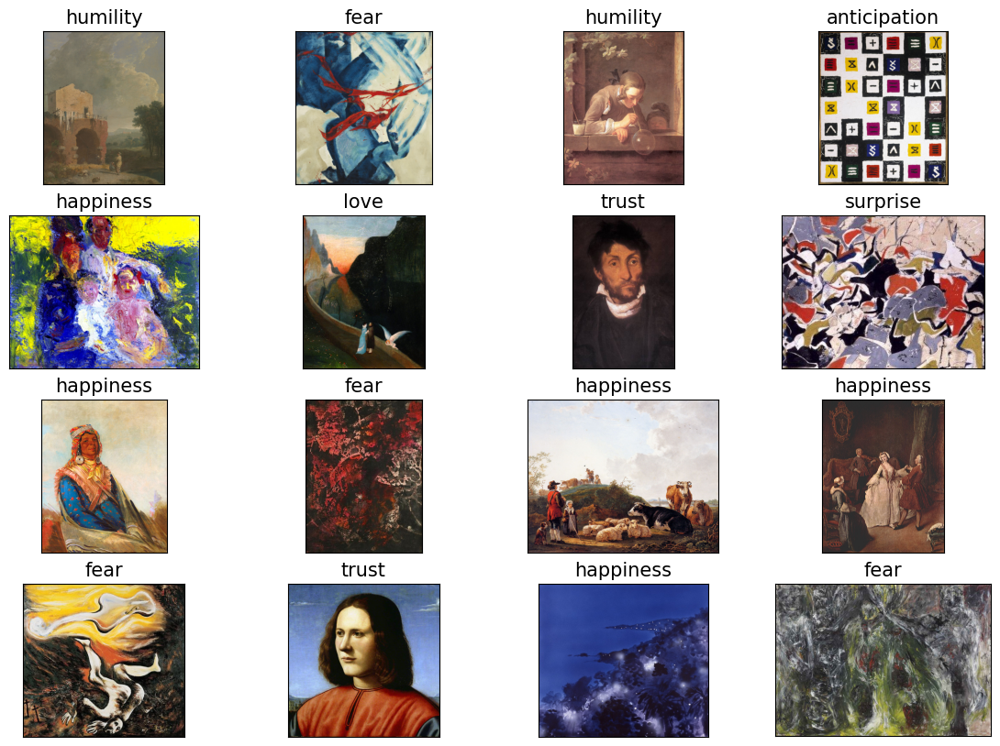

In [ ]:
#Randomly select and display 16 images from the dataset.
images = plt.figure(figsize = (14,10))
for i in range(16):
    random = np.random.randint(1,image_count)
    pic = np.array(PIL.Image.open(path_prob.loc[random,"path"]))
    plt.subplot(4, 4,i+1)
    plt.imshow(pic)
    plt.title(path_prob.loc[random, "emotion"], size = 15)
    plt.xticks([])
    plt.yticks([])

images.show()
images.savefig("EDA_images_show.png", bbox_inches='tight', dpi = 250)

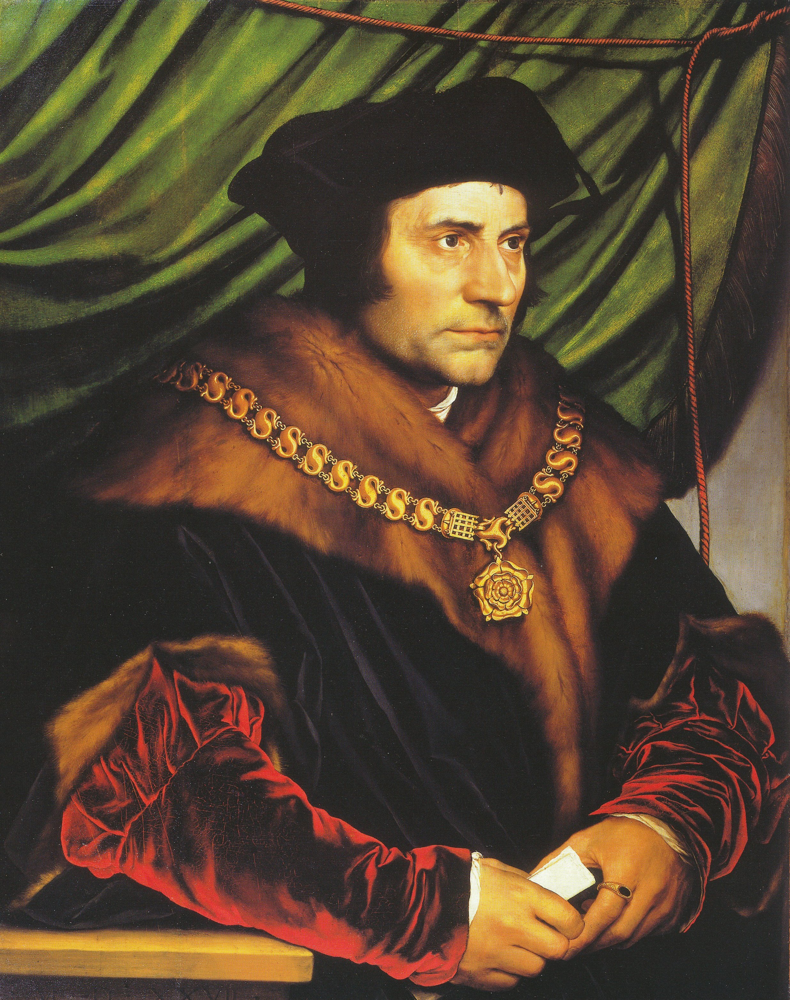

In [ ]:
#This snippet loads and displays the first image from the emo list.
im_0 = PIL.Image.open(str(emo[0]))
im_0

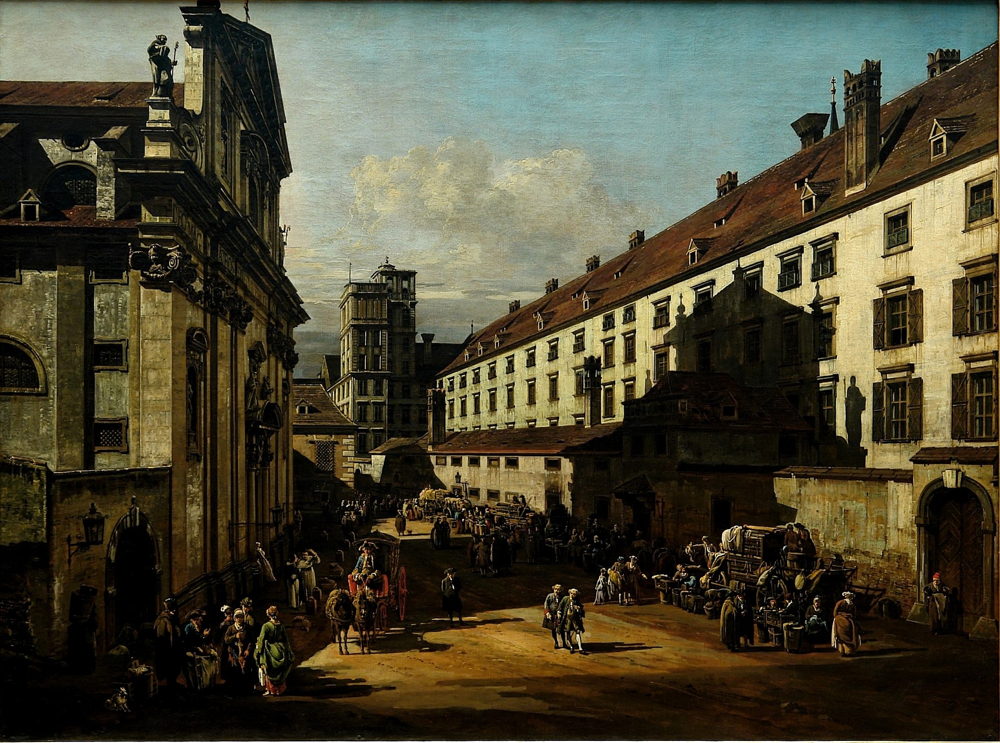

In [ ]:
im_5 = PIL.Image.open(str(emo[5]))
im_5

In [ ]:
# Count the occurrences of each emotion in the dataset.
path_prob.emotion.value_counts()

,count
emotion,
happiness,1102
surprise,822
anticipation,520
trust,478
fear,358
sadness,226
humility,184
love,114
disgust,101


<ipython-input-61-e2869330a70d>:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  g = sns.countplot(path_prob.emotion, palette = "Set2")


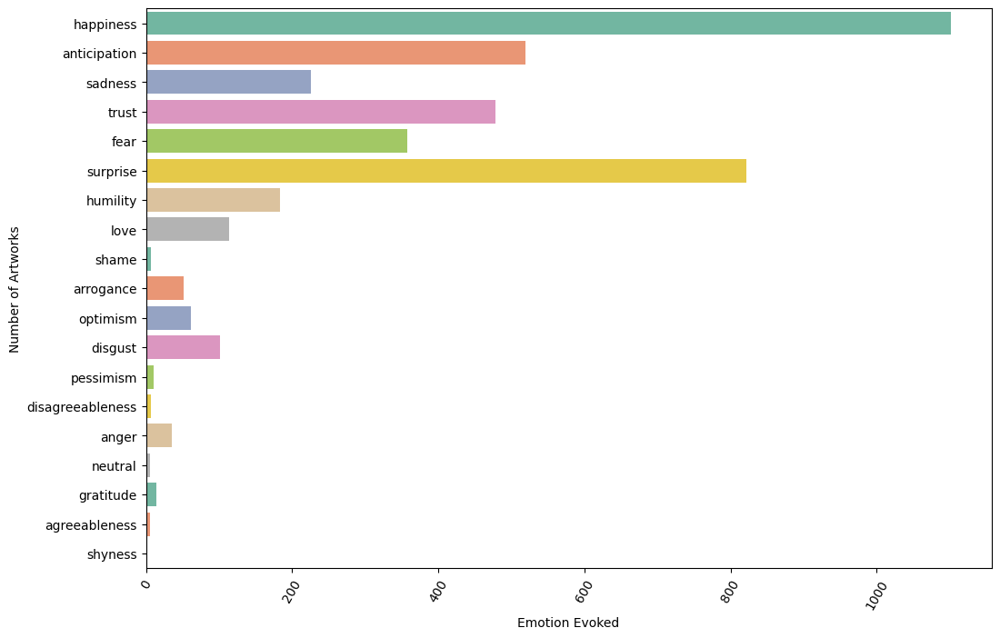

In [ ]:
#Plot the distribution of emotions in the dataset.
emotions = ['agreeableness', 'anger', 'anticipation','arrogance', 'disagreeableness',
       'disgust', 'fear','gratitude', 'happiness', 'humility', 'love',
       'optimism', 'pessimism','regret', 'sadness','shame', 'shyness',
       'surprise', 'trust','neutral']

g = plt.figure(figsize=(12, 8))
g = sns.countplot(path_prob.emotion, palette = "Set2")
g.set(xlabel ='Emotion Evoked', ylabel='Number of Artworks')
plt.xticks(rotation=60)
plt.savefig("Emotion Evoked by Number of Artworks.png", bbox_inches='tight', dpi = 250)

<ipython-input-85-63cd6d10707e>:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=path_prob.emotion.value_counts().index,


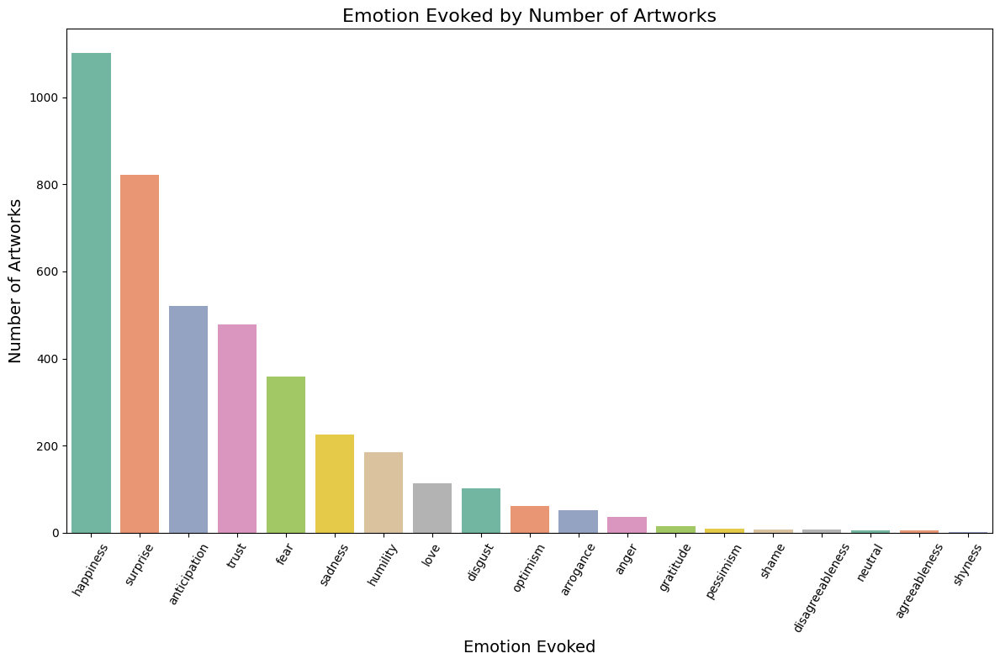

In [ ]:
plt.figure(figsize=(12, 8))
sns.barplot(x=path_prob.emotion.value_counts().index,
            y=path_prob.emotion.value_counts().values,
            palette="Set2")
plt.xlabel("Emotion Evoked", fontsize=14)
plt.ylabel("Number of Artworks", fontsize=14)
plt.xticks(rotation=60)
plt.title("Emotion Evoked by Number of Artworks", fontsize=16)
plt.tight_layout()
plt.savefig("Emotion_Evoked_by_Number_of_Artworks_fixed.png", dpi=250)
plt.show()

In [ ]:
path_all.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4105 entries, 0 to 4104
Data columns (total 28 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   ID                4105 non-null   object
 1   Style             4105 non-null   object
 2   Category          4105 non-null   object
 3   Artist            4105 non-null   object
 4   Title             4105 non-null   object
 5   Is painting       4105 non-null   object
 6   Face/body         4105 non-null   object
 7   agreeableness     4105 non-null   int64 
 8   anger             4105 non-null   int64 
 9   anticipation      4105 non-null   int64 
 10  arrogance         4105 non-null   int64 
 11  disagreeableness  4105 non-null   int64 
 12  disgust           4105 non-null   int64 
 13  fear              4105 non-null   int64 
 14  gratitude         4105 non-null   int64 
 15  happiness         4105 non-null   int64 
 16  humility          4105 non-null   int64 
 17  love          

In [ ]:
#Store the total count for each emotion (presumably columns 7 to 27 correspond to different emotions).
emotion_counts = path_all.iloc[:, 7:27].sum()
emotion_counts

,0
agreeableness,10
anger,78
anticipation,1002
arrogance,131
disagreeableness,27
disgust,206
fear,546
gratitude,116
happiness,1624
humility,773


In [ ]:
#check which columns are indexed from 7 to 27 and ensure these columns are indeed emotions.
path_all.columns

Index(['ID', 'Style', 'Category', 'Artist', 'Title', 'Is painting',
       'Face/body', 'agreeableness', 'anger', 'anticipation', 'arrogance',
       'disagreeableness', 'disgust', 'fear', 'gratitude', 'happiness',
       'humility', 'love', 'optimism', 'pessimism', 'regret', 'sadness',
       'shame', 'shyness', 'surprise', 'trust', 'neutral', 'path'],
      dtype='object')

<ipython-input-72-a5ee2334906c>:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=emotion_counts.index, y=emotion_counts.values, palette="Set2")


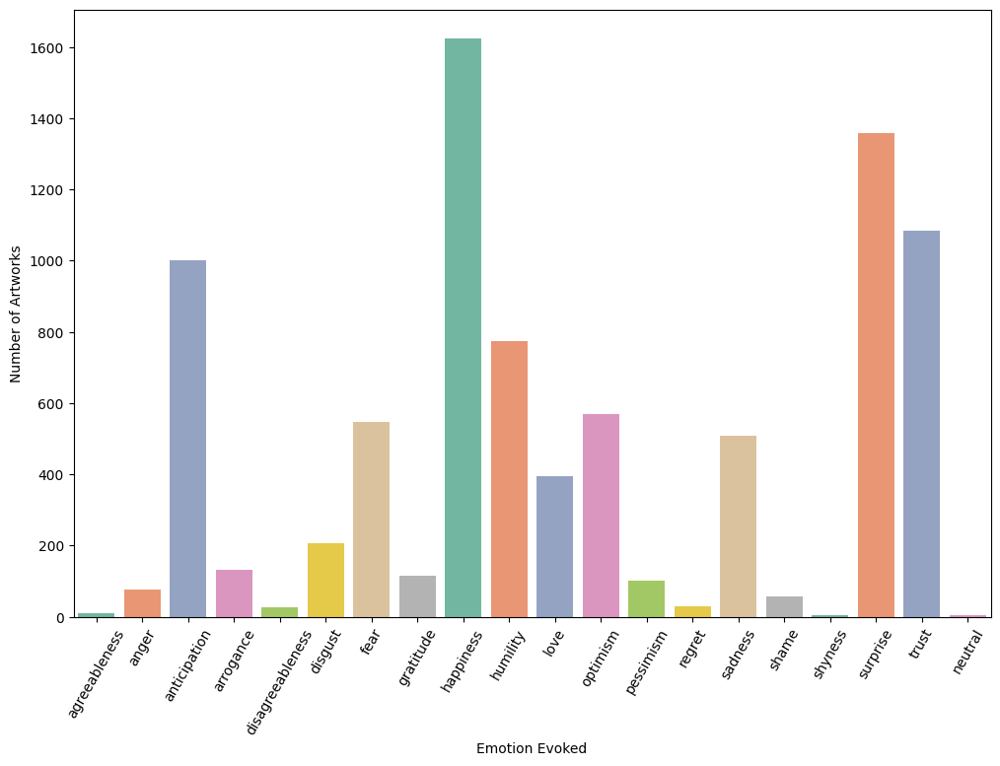

In [ ]:
g = plt.figure(figsize=(12, 8))
sns.barplot(x=emotion_counts.index, y=emotion_counts.values, palette="Set2")
plt.xlabel('Emotion Evoked')
plt.ylabel('Number of Artworks')
plt.xticks(rotation=60)
plt.savefig("All Emotions Evoked by Number of Artworks.png", bbox_inches='tight', dpi=250)

In [ ]:
path_all.head(2)

,ID,Style,Category,Artist,Title,Is painting,Face/body,agreeableness,anger,anticipation,...,optimism,pessimism,regret,sadness,shame,shyness,surprise,trust,neutral,path
0,58c6237dedc2c9c7dc0de1ae,Modern Art,Impressionism,Charles Courtney Curran,In the Luxembourg Garden,yes,face,0,0,0,...,1,0,0,0,0,0,0,0,0,/content/drive/My Drive/WikiArtImages/58c6237d...
1,577280dfedc2cb3880f28e76,Modern Art,Neo-Expressionism,Keith Haring,The Marriage of Heaven and Hell,yes,body,0,0,1,...,0,0,0,0,0,0,1,0,0,/content/drive/My Drive/WikiArtImages/577280df...


In [ ]:
path_all.dtypes

,0
ID,object
Style,object
Category,object
Artist,object
Title,object
Is painting,object
Face/body,object
agreeableness,int64
anger,int64
anticipation,int64


In [ ]:
path_all.to_csv("path_all_3.csv", index= False)

In [ ]:
# Extract the columns with emotions
path_emotions= path_all.iloc[:, 9:]
path_emotions.head(2)

,anticipation,arrogance,disagreeableness,disgust,fear,gratitude,happiness,humility,love,optimism,pessimism,regret,sadness,shame,shyness,surprise,trust,neutral,path
0,0,0,0,0,0,0,1,1,1,1,0,0,0,0,0,0,0,0,/content/drive/My Drive/WikiArtImages/58c6237d...
1,1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,/content/drive/My Drive/WikiArtImages/577280df...


In [ ]:
path_emotions["emotion_list"] = ""

In [ ]:
for col_name in path_emotions.columns:
    path_emotions.loc[path_emotions[col_name]==1,'emotion_list']= path_emotions['emotion_list']+ ' '+ col_name

path_emotions.head(3)

,anticipation,arrogance,disagreeableness,disgust,fear,gratitude,happiness,humility,love,optimism,pessimism,regret,sadness,shame,shyness,surprise,trust,neutral,path,emotion_list
0,0,0,0,0,0,0,1,1,1,1,0,0,0,0,0,0,0,0,/content/drive/My Drive/WikiArtImages/58c6237d...,happiness humility love optimism
1,1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,/content/drive/My Drive/WikiArtImages/577280df...,anticipation disagreeableness fear surprise
2,0,0,0,0,0,0,1,1,0,1,0,0,0,0,0,0,1,0,/content/drive/My Drive/WikiArtImages/57727f2d...,happiness humility optimism trust


In [ ]:
path_emotions.emotion_list = path_emotions.emotion_list.str.strip()
path_emotions.head(2)

,anticipation,arrogance,disagreeableness,disgust,fear,gratitude,happiness,humility,love,optimism,pessimism,regret,sadness,shame,shyness,surprise,trust,neutral,path,emotion_list
0,0,0,0,0,0,0,1,1,1,1,0,0,0,0,0,0,0,0,/content/drive/My Drive/WikiArtImages/58c6237d...,happiness humility love optimism
1,1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,/content/drive/My Drive/WikiArtImages/577280df...,anticipation disagreeableness fear surprise


In [ ]:
#Sanity check looking at a specific painting with multiple layers
path_emotions.iloc[1, 13]

0

In [ ]:
#Get rid of all those paintings with no emotion attached to them
#The last column, emotion_list, represents a concatenated string of all the emotions associated with a particular image.
path_emotions = path_emotions[path_emotions.emotion_list != ""]
path_emotions.head(2)

,anticipation,arrogance,disagreeableness,disgust,fear,gratitude,happiness,humility,love,optimism,pessimism,regret,sadness,shame,shyness,surprise,trust,neutral,path,emotion_list
0,0,0,0,0,0,0,1,1,1,1,0,0,0,0,0,0,0,0,/content/drive/My Drive/WikiArtImages/58c6237d...,happiness humility love optimism
1,1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,/content/drive/My Drive/WikiArtImages/577280df...,anticipation disagreeableness fear surprise


from matplotlib import pyplot as plt
_df_0['anticipation'].plot(kind='hist', bins=20, title='anticipation')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_1['disagreeableness'].plot(kind='hist', bins=20, title='disagreeableness')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_2['fear'].plot(kind='hist', bins=20, title='fear')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_3['happiness'].plot(kind='hist', bins=20, title='happiness')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
_df_4.groupby('path').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
_df_5.groupby('emotion_list').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_6.plot(kind='scatter', x='anticipation', y='disagreeableness', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_7.plot(kind='scatter', x='disagreeableness', y='fear', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_8.plot(kind='scatter', x='fear', y='happiness', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_9.plot(kind='scatter', x='happiness', y='humility', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['anticipation']
  ys = series['happiness']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_10.sort_values('anticipation', ascending=True)
for i, (series_name, series) in enumerate(df_sorted.groupby('path')):
  _plot_series(series, series_name, i)
  fig.legend(title='path', bbox_to_anchor=(1, 1), loc='upper left')
sns.despine(fig=fig, ax=ax)
plt.xlabel('anticipation')
_ = plt.ylabel('happiness')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['anticipation']
  ys = series['happiness']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_11.sort_values('anticipation', ascending=True)
for i, (series_name, series) in enumerate(df_sorted.groupby('emotion_list')):
  _plot_series(series, series_name, i)
  fig.legend(title='emotion_list', bbox_to_anchor=(1, 1), loc='upper left')
sns.despine(fig=fig, ax=ax)
plt.xlabel('anticipation')
_ = plt.ylabel('happiness')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['anticipation']
  ys = series['humility']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_12.sort_values('anticipation', ascending=True)
for i, (series_name, series) in enumerate(df_sorted.groupby('path')):
  _plot_series(series, series_name, i)
  fig.legend(title='path', bbox_to_anchor=(1, 1), loc='upper left')
sns.despine(fig=fig, ax=ax)
plt.xlabel('anticipation')
_ = plt.ylabel('humility')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['anticipation']
  ys = series['humility']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_13.sort_values('anticipation', ascending=True)
for i, (series_name, series) in enumerate(df_sorted.groupby('emotion_list')):
  _plot_series(series, series_name, i)
  fig.legend(title='emotion_list', bbox_to_anchor=(1, 1), loc='upper left')
sns.despine(fig=fig, ax=ax)
plt.xlabel('anticipation')
_ = plt.ylabel('humility')

from matplotlib import pyplot as plt
_df_14['anticipation'].plot(kind='line', figsize=(8, 4), title='anticipation')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
_df_15['disagreeableness'].plot(kind='line', figsize=(8, 4), title='disagreeableness')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
_df_16['fear'].plot(kind='line', figsize=(8, 4), title='fear')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
_df_17['happiness'].plot(kind='line', figsize=(8, 4), title='happiness')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
import pandas as pd
plt.subplots(figsize=(8, 8))
df_2dhist = pd.DataFrame({
    x_label: grp['emotion_list'].value_counts()
    for x_label, grp in _df_18.groupby('path')
})
sns.heatmap(df_2dhist, cmap='viridis')
plt.xlabel('path')
_ = plt.ylabel('emotion_list')

<string>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.



from matplotlib import pyplot as plt
import seaborn as sns
figsize = (12, 1.2 * len(_df_19['path'].unique()))
plt.figure(figsize=figsize)
sns.violinplot(_df_19, x='anticipation', y='path', inner='stick', palette='Dark2')
sns.despine(top=True, right=True, bottom=True, left=True)

<string>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.



from matplotlib import pyplot as plt
import seaborn as sns
figsize = (12, 1.2 * len(_df_20['emotion_list'].unique()))
plt.figure(figsize=figsize)
sns.violinplot(_df_20, x='anticipation', y='emotion_list', inner='stick', palette='Dark2')
sns.despine(top=True, right=True, bottom=True, left=True)

<string>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.



from matplotlib import pyplot as plt
import seaborn as sns
figsize = (12, 1.2 * len(_df_21['path'].unique()))
plt.figure(figsize=figsize)
sns.violinplot(_df_21, x='disagreeableness', y='path', inner='stick', palette='Dark2')
sns.despine(top=True, right=True, bottom=True, left=True)

<string>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.



from matplotlib import pyplot as plt
import seaborn as sns
figsize = (12, 1.2 * len(_df_22['emotion_list'].unique()))
plt.figure(figsize=figsize)
sns.violinplot(_df_22, x='disagreeableness', y='emotion_list', inner='stick', palette='Dark2')
sns.despine(top=True, right=True, bottom=True, left=True)

In [ ]:
path_emotions.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3923 entries, 0 to 4104
Data columns (total 20 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   anticipation      3923 non-null   int64 
 1   arrogance         3923 non-null   int64 
 2   disagreeableness  3923 non-null   int64 
 3   disgust           3923 non-null   int64 
 4   fear              3923 non-null   int64 
 5   gratitude         3923 non-null   int64 
 6   happiness         3923 non-null   int64 
 7   humility          3923 non-null   int64 
 8   love              3923 non-null   int64 
 9   optimism          3923 non-null   int64 
 10  pessimism         3923 non-null   int64 
 11  regret            3923 non-null   int64 
 12  sadness           3923 non-null   int64 
 13  shame             3923 non-null   int64 
 14  shyness           3923 non-null   int64 
 15  surprise          3923 non-null   int64 
 16  trust             3923 non-null   int64 
 17  neutral           3

In [ ]:
path_emotions.to_csv("path_emotions.csv", index= False)

In [ ]:
path_prob.pto_csv("path_prob.csv")

NameError: name 'ath_prob' is not defined

In [ ]:
import shutil
import os

# Specify the folder path in Google Drive
folder_path = '/content/drive/MyDrive/6893Data'

# Create the folder if it doesn't exist
if not os.path.exists(folder_path):
    os.makedirs(folder_path)
    print(f"Folder '{folder_path}' created successfully!")
else:
    print(f"Folder '{folder_path}' already exists.")

# Specify the source and destination paths
shutil.copy('/content/path_all_3.csv', '/content/drive/MyDrive/6893Data/path_all_3.csv')
shutil.copy('/content/path_emotions.csv', '/content/drive/MyDrive/6893Data/path_emotions.csv')
shutil.copy('/content/path_prob.csv', '/content/drive/MyDrive/6893Data/path_prob.csv')

Folder '/content/drive/MyDrive/6893Data' created successfully!


'/content/drive/MyDrive/6893Data/path_prob.csv'